# Business case: Understanding profitability in the US financial market

This is business case prepared for the Statistics Module (Bloque 1) of the Advanced AI concentration

## Case Description

You were hired as a data scientist in an important mutual fund firm in the department of financial analysis. The firm has been doing financial analysis and financial forecast for several years. You were hired to come up with alternative approaches to do descriptive analytics in order to find better future alternatives for forecasting methods.

You have to analyze historical quarterly financial statements of all US public firms listed in the New York Exchange and NASDAQ. You will receive this dataset in a .csv format.

You have to carefully read the data dictionary to understand each variable and the dataset to understand its structure.

## Business Questions

All your data and statistical analysis has to be tailored to respond the following questions:

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns

### Open de .csv files

In [4]:
# https://apradie.com/datos/us2022q2a.csv
us = pd.read_csv('us2022q2a.csv')

# https://apradie.com/datos/usfirms2022.csv
firms = pd.read_csv('usfirms2022.csv')

In [5]:
us.columns

Index(['firm', 'q', 'revenue', 'cogs', 'sgae', 'otheropexp', 'extraincome',
       'finexp', 'incometax', 'totalassets', 'totalliabilities', 'shortdebt',
       'longdebt', 'stockholderequity', 'adjprice', 'originalprice',
       'sharesoutstanding', 'fiscalmonth', 'year', 'cto'],
      dtype='object')

In [6]:
firms.columns

Index(['Ticker', 'Name', 'N', 'Class', 'Country\nof Origin', 'Type of Asset',
       'Sector NAICS\nlevel 1', 'Exchange / Src', 'Sector\nEconomatica',
       'Sector NAICS\nlast available', 'partind'],
      dtype='object')

### Specific questions:
-----

#### __About descriptive statistics:__

##### Considering the most recent financial quarter of the dataset:

- __Show how many firms by industry there are in the sample__

In [7]:
firmsbyindustry = firms['Sector NAICS\nlevel 1'].value_counts()
firmsbyindustry

Manufacturing                                                               1567
Finance and Insurance                                                        703
Information                                                                  263
Retail Trade                                                                 152
Professional, Scientific, and Technical Services                             145
Administrative and Support and Waste Management and Remediation Services     133
Mining, Quarrying, and Oil and Gas Extraction                                104
Wholesale Trade                                                               79
Utilities                                                                     77
Transportation and Warehousing                                                69
Accommodation and Food Services                                               69
Real Estate and Rental and Leasing                                            68
Health Care and Social Assis

- __For each industry (and for all industries), what can you say about the typical firm size in terms of market value and book value? How much these variables change within each industry? How firm size (in market value) is distributed?__

In [8]:
px.histogram(firms['Sector NAICS\nlevel 1'])

### Merge both tables

In [9]:
us_firms = us.merge(firms, left_on='firm', right_on='Ticker')
us_firms.head()

,firm,q,revenue,cogs,sgae,otheropexp,extraincome,finexp,incometax,totalassets,...,Name,N,Class,Country\nof Origin,Type of Asset,Sector NAICS\nlevel 1,Exchange / Src,Sector\nEconomatica,Sector NAICS\nlast available,partind
0,A,2000q1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,"Agilent Technologies, Inc",94,Com,US,Stock,Manufacturing,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124
1,A,2000q2,2485000.0,1261000.0,1010000.0,0.0,42000.0,0.0,90000.0,7321000.0,...,"Agilent Technologies, Inc",94,Com,US,Stock,Manufacturing,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124
2,A,2000q3,2670000.0,1369000.0,1091000.0,0.0,28000.0,0.0,83000.0,7827000.0,...,"Agilent Technologies, Inc",94,Com,US,Stock,Manufacturing,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124
3,A,2000q4,3372000.0,1732000.0,1182000.0,0.0,10000.0,0.0,163000.0,8425000.0,...,"Agilent Technologies, Inc",94,Com,US,Stock,Manufacturing,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124
4,A,2001q1,2841000.0,1449000.0,1113000.0,0.0,-6000.0,0.0,119000.0,9208000.0,...,"Agilent Technologies, Inc",94,Com,US,Stock,Manufacturing,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124


### Get variable calculations

Variable calculations:
  - Firm size measures:
    + Book value of the firm = (totalassets-totalliabilities)
    + Market value = (precio del stock histórico)
    + Market value = (originalprice * sharesoutstanding)
    <br><br>
  - Profit Margin measures:
    + Operating profit margin = operating profit / sales
      * Operating profit = ebit = (revenue - cogs - sgae - otheropexp)
      * Cogs = Cost of Good Sold = Variable cost
      * Sgae = Sales and General Administrative Expenses = Fixed costs
      * Ebit = Earning before Interst and Taxes = Operating profit

	ebit = revenue - cogs - sgae - otheropexp<br>
	operating profit margin = opm = ebit / revenue<br>
  revenue = sales<br>

    Profit margin = Net income / sales<br>
    Net income = ebit - incometax - finexp<br>
    Income tax = what the firm pays in taxes (for the government)(impuesto sobre la renta)<br>
    Finexp = financial expenses = what the firm pays in interest expenses for any loan that the firm issued<br>

In [10]:
# Firm size measures
us_firms['Book value of the firms'] = us_firms['totalassets'] - us_firms['totalliabilities']
us_firms['Market value'] = us_firms['originalprice'] * us_firms['sharesoutstanding']

# Profit Margin measures
us_firms['Operating profit'] = us_firms['revenue'] - us_firms['cogs'] - us_firms['sgae'] - us_firms['otheropexp']
# us_firms['Ebit'] = us_firms['revenue'] - us_firms['cogs'] - us_firms['sgae'] - us_firms['otheropexp']
us_firms['opm'] = us_firms['Operating profit'] / us_firms['revenue']
us_firms['Net income'] = us_firms['Operating profit'] - us_firms['incometax'] - us_firms['finexp']
us_firms['Profit margin'] = us_firms['Net income'] / us_firms['revenue']
us_firms.head()

,firm,q,revenue,cogs,sgae,otheropexp,extraincome,finexp,incometax,totalassets,...,Exchange / Src,Sector\nEconomatica,Sector NAICS\nlast available,partind,Book value of the firms,Market value,Operating profit,opm,Net income,Profit margin
0,A,2000q1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,NaN,4.700800e+07,NaN,NaN,NaN,NaN
1,A,2000q2,2485000.0,1261000.0,1010000.0,0.0,42000.0,0.0,90000.0,7321000.0,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,4642000.0,3.335506e+07,214000.0,0.086117,124000.0,0.049899
2,A,2000q3,2670000.0,1369000.0,1091000.0,0.0,28000.0,0.0,83000.0,7827000.0,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,4902000.0,2.216940e+07,210000.0,0.078652,127000.0,0.047566
3,A,2000q4,3372000.0,1732000.0,1182000.0,0.0,10000.0,0.0,163000.0,8425000.0,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,5265000.0,2.498606e+07,458000.0,0.135824,295000.0,0.087485
4,A,2001q1,2841000.0,1449000.0,1113000.0,0.0,-6000.0,0.0,119000.0,9208000.0,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,5541000.0,1.403653e+07,279000.0,0.098205,160000.0,0.056318


In [11]:
aux = us_firms['q'] == '2022q2'
us_firms2022 = us_firms[aux]
us_firms2022.head()

,firm,q,revenue,cogs,sgae,otheropexp,extraincome,finexp,incometax,totalassets,...,Exchange / Src,Sector\nEconomatica,Sector NAICS\nlast available,partind,Book value of the firms,Market value,Operating profit,opm,Net income,Profit margin
89,A,2022q2,1607000.0,746000.0,501000.0,0.0,-7000.0,20000.0,59000.0,10455000.0,...,NYSE,Electric Electron,"Navigational, Measuring, Electromedical, and C...",0.124,5122000.0,3.547756e+07,360000.0,0.224020,281000.0,0.174860
179,AA,2022q2,3644000.0,2767000.0,220000.0,-75000.0,81000.0,30000.0,234000.0,15709000.0,...,NYSE,Basic & Fab Metal,Alumina and Aluminum Production and Processing,-,7292000.0,8.407171e+06,732000.0,0.200878,468000.0,0.128430
269,AAIC,2022q2,10900.0,6374.0,0.0,0.0,-3417.0,0.0,802.0,1084755.0,...,NYSE,Funds,Other Investment Pools and Funds,-,213698.0,1.138033e+05,4526.0,0.415229,3724.0,0.341651
359,AAL,2022q2,13422000.0,0.0,12405000.0,0.0,25000.0,439000.0,127000.0,67963000.0,...,NASDAQ,Transportat Serv,Scheduled Air Transportation,0.032,-8422000.0,8.235848e+06,1017000.0,0.075771,451000.0,0.033602
449,AAME,2022q2,44669.0,0.0,46784.0,0.0,0.0,0.0,-436.0,379274.0,...,NASDAQ,Finance and Insurance,Insurance Carriers,-,109101.0,5.446399e+04,-2115.0,-0.047348,-1679.0,-0.037588


### Book value of the firms analisys

In [12]:
px.line(us_firms, x = 'q', y = 'Book value of the firms', color = 'Sector NAICS\nlevel 1')

In [13]:
px.histogram(us_firms2022['Book value of the firms'])

OBTENEMOS LA MEDIANA PORQUE LOS DATOS DE LA MEDIA SE ENCUENTRAN MUY SESGADOS

In [15]:
us_firms2022['Book value of the firms'].median()

457737.0

### Market Value analisys

In [16]:
px.line(us_firms, x = 'q', y = 'Market value', color = 'Sector NAICS\nlevel 1')

In [17]:
px.histogram(us_firms2022['Market value'])

OBTENEMOS LA MEDIANA PORQUE LOS DATOS DE LA MEDIA SE ENCUENTRAN MUY SESGADOS

In [18]:
us_firms2022['Market value'].median()

1105075.91083

- __For each industry (and for all industries), what can you say about profit margin of firms? show a) descriptive statistics of profit margin and b) plot(s) to illustrate how profit margin changes across industries.__

c:\Users\Oscar\anaconda3\envs\DL\lib\site-packages\numpy\core\_methods.py:179: RuntimeWarning:

invalid value encountered in reduce

c:\Users\Oscar\anaconda3\envs\DL\lib\site-packages\numpy\core\_methods.py:179: RuntimeWarning:

invalid value encountered in reduce



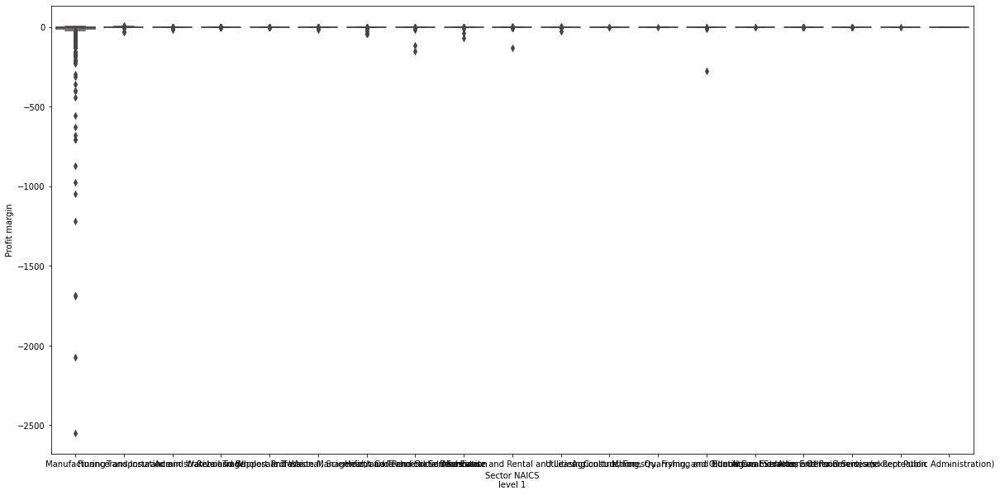

In [19]:
plt.figure(figsize=(20,10))
sns.boxplot(x = 'Sector NAICS\nlevel 1', y= 'Profit margin', data=us_firms2022);

- __Which are the biggest 10 US firms in terms of market value and how far they are from the typical size of a US firm?__

In [12]:
top10 = us_firms2022.sort_values('Market value', ascending=False).head(10)
top10

,firm,q,revenue,cogs,sgae,otheropexp,extraincome,finexp,incometax,totalassets,...,Exchange / Src,Sector\nEconomatica,Sector NAICS\nlast available,partind,Book value of the firms,Market value,Operating profit,opm,Net income,Profit margin
809,AAPL,2022q2,82959000.0,47074000.0,12809000.0,0.0,-10000.0,0.0,3624000.0,336309000.0,...,NASDAQ,Electric Electron,Computer and Peripheral Equipment Manufacturing,6.056,58107000.0,2.212838e+09,23076000.0,0.278162,19452000.0,0.234477
191175,MSFT,2022q2,51865000.0,16429000.0,14902000.0,0.0,-47000.0,0.0,3747000.0,364840000.0,...,NASDAQ,Software & Data,Software Publishers,6.026,166542000.0,1.920840e+09,20534000.0,0.395912,16787000.0,0.323667
125851,GOOGL,2022q2,69685000.0,30104000.0,20128000.0,0.0,-439000.0,0.0,3012000.0,355185000.0,...,NASDAQ,Other,"Professional, Scientific, and Technical Services",2.149,255419000.0,1.435042e+09,19453000.0,0.279156,16441000.0,0.235933
18173,AMZN,2022q2,121234000.0,66424000.0,51403000.0,90000.0,-5557000.0,425000.0,-637000.0,419728000.0,...,NASDAQ,Trade,Electronic Shopping and Mail-Order Houses,3.768,131402000.0,1.080624e+09,3317000.0,0.027360,3529000.0,0.029109
289525,TSLA,2022q2,16934000.0,12700000.0,1628000.0,142000.0,18000.0,18000.0,205000.0,68513000.0,...,NASDAQ,Vehicle & Parts,Motor Vehicle Manufacturing,1.915,37237000.0,6.976698e+08,2464000.0,0.145506,2241000.0,0.132337
296815,UNH,2022q2,80332000.0,73200000.0,0.0,0.0,-129000.0,467000.0,1466000.0,230172000.0,...,NYSE,Finance and Insurance,Insurance Carriers,1.099,76205000.0,4.818731e+08,7132000.0,0.088782,5199000.0,0.064719
156887,JNJ,2022q2,24020000.0,7919000.0,9929000.0,85000.0,-273000.0,-26000.0,1026000.0,177724000.0,...,NYSE,Chemical,Pharmaceutical and Medicine Manufacturing,1.118,76357000.0,4.671001e+08,6087000.0,0.253414,5087000.0,0.211782
182535,META,2022q2,28822000.0,5192000.0,15272000.0,0.0,-172000.0,0.0,1499000.0,169779000.0,...,NASDAQ,Other,"Professional, Scientific, and Technical Services",2.007,125767000.0,4.363946e+08,8358000.0,0.289987,6859000.0,0.237978
205565,NVDA,2022q2,8288000.0,2857000.0,2210000.0,1353000.0,-13000.0,50000.0,187000.0,45212000.0,...,NASDAQ,Electric Electron,Semiconductor and Other Electronic Component M...,1.469,26320000.0,3.789750e+08,1868000.0,0.225386,1631000.0,0.196791
300325,V,2022q2,7275000.0,0.0,3127000.0,0.0,-208000.0,111000.0,418000.0,85410000.0,...,NYSE,Other,Business Support Services,1.012,35483000.0,3.743426e+08,4148000.0,0.570172,3619000.0,0.497457


- __Which are the biggest 10 US firms in terms of book value and how far they are from the typical size of a US firm?__

In [13]:
top10 = us_firms2022.sort_values('Book value of the firms', ascending=False).head(10) # Valor contable de la empresa
top10

,firm,q,revenue,cogs,sgae,otheropexp,extraincome,finexp,incometax,totalassets,...,Exchange / Src,Sector\nEconomatica,Sector NAICS\nlast available,partind,Book value of the firms,Market value,Operating profit,opm,Net income,Profit margin
157427,JPM,2022q2,18646000.0,3518000.0,0.0,0.0,-4263000.0,0.0,2216000.0,3.841314e+09,...,NYSE,Finance and Insurance,Depository Credit Intermediation,1.331,286143000.0,3.302370e+08,15128000.0,0.811327,12912000.0,0.692481
34013,BAC,2022q2,14975000.0,2531000.0,0.0,0.0,-5552000.0,0.0,645000.0,3.111606e+09,...,NYSE,Finance and Insurance,Depository Credit Intermediation,0.914,269118000.0,2.508107e+08,12444000.0,0.830985,11799000.0,0.787913
125851,GOOGL,2022q2,69685000.0,30104000.0,20128000.0,0.0,-439000.0,0.0,3012000.0,3.551850e+08,...,NASDAQ,Other,"Professional, Scientific, and Technical Services",2.149,255419000.0,1.435042e+09,19453000.0,0.279156,16441000.0,0.235933
49680,C,2022q2,15630000.0,3666000.0,0.0,0.0,-6235000.0,0.0,1182000.0,2.380904e+09,...,NYSE,Finance and Insurance,Depository Credit Intermediation,0.375,199626000.0,8.906928e+07,11964000.0,0.765451,10782000.0,0.689827
319405,XOM,2022q2,111265000.0,76299000.0,6981000.0,7154000.0,3572000.0,194000.0,6359000.0,3.677740e+08,...,NYSE,Oil & Gas,Petroleum and Coal Products Manufacturing,0.693,184508000.0,3.569164e+08,20831000.0,0.187220,14278000.0,0.128324
312205,WFC,2022q2,11556000.0,1358000.0,0.0,0.0,-6466000.0,0.0,613000.0,1.881142e+09,...,NYSE,Finance and Insurance,Depository Credit Intermediation,0.540,179793000.0,1.484681e+08,10198000.0,0.882485,9585000.0,0.829439
191175,MSFT,2022q2,51865000.0,16429000.0,14902000.0,0.0,-47000.0,0.0,3747000.0,3.648400e+08,...,NASDAQ,Software & Data,Software Publishers,6.026,166542000.0,1.920840e+09,20534000.0,0.395912,16787000.0,0.323667
78332,CVX,2022q2,68762000.0,46321000.0,4563000.0,1759000.0,-80000.0,129000.0,4288000.0,2.579360e+08,...,NYSE,Oil & Gas,Petroleum and Coal Products Manufacturing,0.566,154562000.0,2.833974e+08,16119000.0,0.234417,11702000.0,0.170181
277650,T,2022q2,29643000.0,12341000.0,11715000.0,631000.0,2212000.0,1502000.0,1509000.0,4.264330e+08,...,NYSE,Telecommunication,Wired Telecommunications Carriers,0.472,135307000.0,1.500526e+08,4956000.0,0.167190,1945000.0,0.065614
18173,AMZN,2022q2,121234000.0,66424000.0,51403000.0,90000.0,-5557000.0,425000.0,-637000.0,4.197280e+08,...,NASDAQ,Trade,Electronic Shopping and Mail-Order Houses,3.768,131402000.0,1.080624e+09,3317000.0,0.027360,3529000.0,0.029109


##### Considering the whole history of financial data for all firms:

- __How can you measure firm profitability that can be used to compare performance among firms of different sizes? Select and justify at least 3 measures and show descriptive statistics__

In [14]:
df_corrs = us_firms.corr()["Operating profit"]
df_corrs

revenue                    0.589684
cogs                       0.400980
sgae                       0.408224
otheropexp                 0.089008
extraincome               -0.334447
finexp                     0.376243
incometax                  0.571073
totalassets                0.608279
totalliabilities           0.571247
shortdebt                  0.397085
longdebt                   0.593451
stockholderequity          0.743806
adjprice                  -0.002079
originalprice              0.120425
sharesoutstanding          0.619968
fiscalmonth               -0.007204
year                      -0.040876
cto                       -0.004961
N                         -0.022436
Book value of the firms    0.743873
Market value               0.689132
Operating profit           1.000000
opm                        0.004686
Net income                 0.941835
Profit margin              0.004748
Name: Operating profit, dtype: float64

In [32]:
px.histogram(us_firms2022, x='Sector NAICS\nlevel 1', y='Operating profit')

- __Calculate and explain earnings per share deflated by price.__